In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import pandas as pd
import re # for regular expressions
import string # look at punctuations
from sklearn.feature_extraction.text import CountVectorizer #to convert text to Document term matrix
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import seaborn as sns
%matplotlib inline
import plotly as py
import cufflinks as cf
from plotly.offline import iplot
py.offline.init_notebook_mode(connected=True)
cf.go_offline()
from textblob import TextBlob

#make plotly work in Colab
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)
  import spacy


Clothing Review

In [5]:
df = pd.read_csv('/content/drive/My Drive/Colab Notebooks/Womens Clothing E-Commerce Reviews.csv', index_col = 0)

In [6]:
df.head()


,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [7]:
df.shape

(23486, 10)

In [10]:
#drop unneeded columns and remove NA's
#df.drop(labels = ['Title', 'Clothing ID'], axis =1, inplace=True)
df.isnull().sum()
df.dropna(subset = ['Review Text', 'Division Name'], inplace = True)
df['cleaned']=df['Review Text'].apply(lambda x: x.lower())
df['cleaned']=df['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))
df['cleaned']=df['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))

In [11]:
import spacy
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
df['lemmatized']=df['cleaned'].apply(lambda x: ' '.join([token.lemma_ for token in list(nlp(x)) if (token.is_stop==False)]))

In [12]:
df_grouped=df[['Department Name','lemmatized']].groupby(by='Department Name').agg(lambda x:' '.join(x))
df_grouped.head()

,lemmatized
Department Name,
Bottoms,love love love jumpsuit fun flirty fabulous ti...
Dresses,love dress sooo pretty happen find store b...
Intimate,absolutely wonderful silky sexy comfortable ...
Jackets,flattering super cozy coat work cold dry day...
Tops,shirt flattering adjustable tie perfect length...


In [13]:
from sklearn.feature_extraction.text import CountVectorizer 
cv=CountVectorizer(analyzer='word')
data=cv.fit_transform(df_grouped['lemmatized'])
df_dtm = pd.DataFrame(data.toarray(), columns=cv.get_feature_names())
df_dtm.index=df_grouped.index
df_dtm.head(3)

,aa,aaaaaaamaze,aaaaandidontwanttopayforshipping,aaaaannnnnnd,aaaah,aaaahmaze,aaahe,aame,ab,abbey,abby,abck,abdoman,abdomen,abdominal,abercrombie,abhor,ability,abject,able,abnormal,abnormally,abo,abolutely,abou,abovetheknee,abovetheshoulder,abroad,abruptly,absence,abso,absolute,absolutely,absolutley,absolutly,absoluty,absorbent,abstract,absurd,absurdly,...,youth,youthful,youthfull,youthis,youwow,yr,yrs,yuck,yucky,yuk,yumi,yummy,yup,zag,zara,ze,zermatt,zero,zig,zigzag,zigzagging,zillion,zip,zipbutton,zipepr,ziphoodie,ziploc,zipp,zippedfor,zipper,zippered,zipperi,zipperone,zippie,zombie,zone,zoolander,zoom,zuma,ã¼ber
Department Name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Bottoms,1,0,0,0,0,0,0,0,3,0,0,0,1,1,0,1,1,2,0,72,0,1,1,1,0,1,0,0,0,0,0,4,128,0,0,0,0,0,1,0,...,1,0,0,1,1,0,1,1,0,0,0,2,0,0,1,0,0,6,0,0,0,1,84,1,0,0,0,0,0,81,0,1,0,0,0,0,0,2,0,0
Dresses,1,0,0,0,1,0,1,1,1,0,2,0,3,0,1,0,0,7,1,132,0,0,1,0,1,1,0,1,1,1,0,10,274,1,0,1,0,3,0,1,...,1,8,1,0,0,1,1,0,3,0,1,1,2,1,0,0,0,13,1,0,0,1,120,0,1,0,0,1,0,208,1,0,1,0,0,4,1,1,0,0
Intimate,0,0,0,0,0,1,0,0,2,0,0,1,1,0,0,0,0,0,0,22,0,0,0,0,0,0,0,0,0,0,1,4,59,0,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,8,0,2,0,0,7,0,0,1,0,0,1,17,0,0,0,1,0,0,0,0,1,0


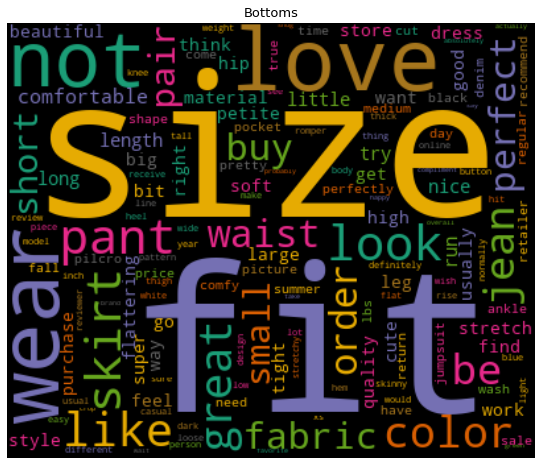

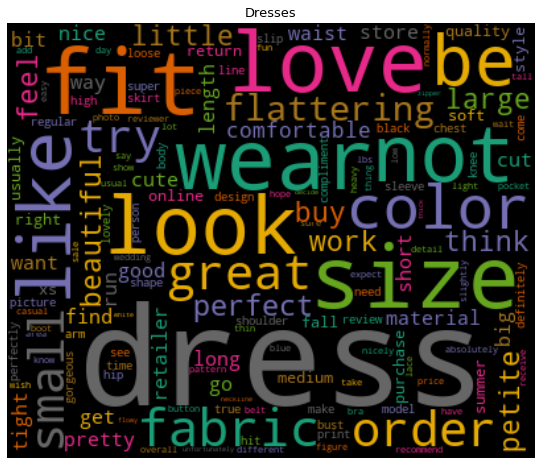

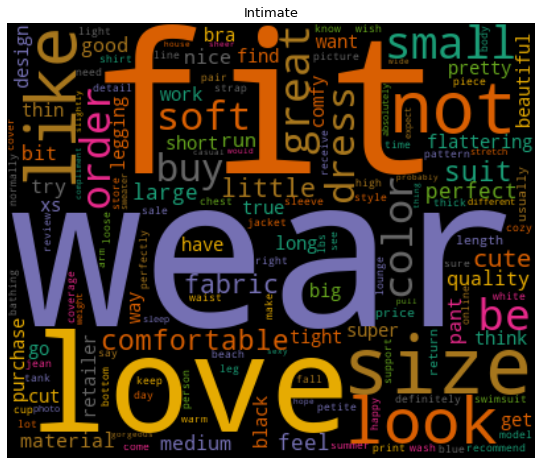

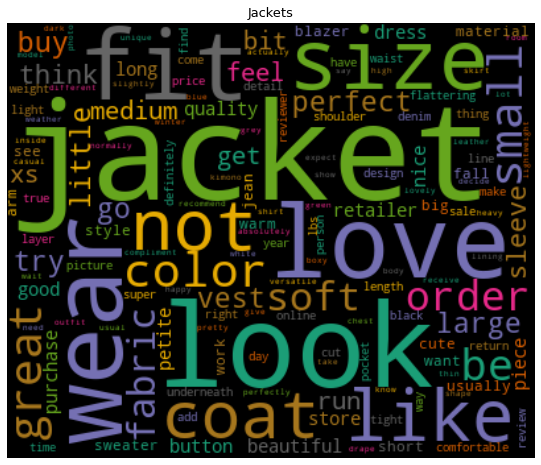

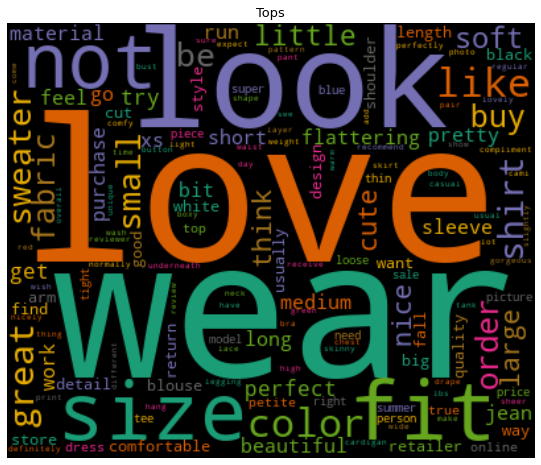

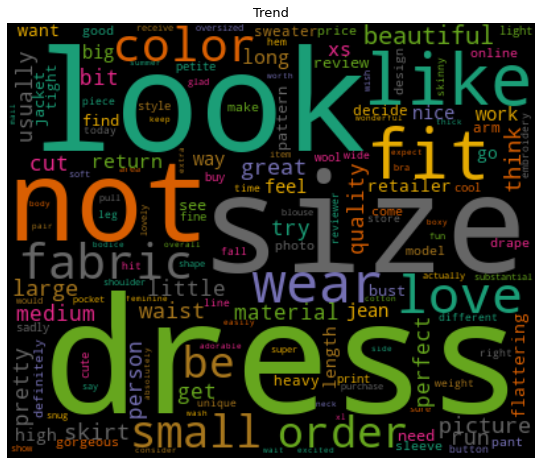

In [14]:
# Importing wordcloud for plotting word clouds and textwrap for wrapping longer text
from wordcloud import WordCloud
from textwrap import wrap

# Function for generating word clouds
def generate_wordcloud(data,title):
  wc = WordCloud(width=400, height=330, max_words=150,colormap="Dark2").generate_from_frequencies(data)
  plt.figure(figsize=(10,8))
  plt.imshow(wc, interpolation='bilinear')
  plt.axis("off")
  plt.title('\n'.join(wrap(title,60)),fontsize=13)
  plt.show()
  
# Transposing document term matrix
df_dtm=df_dtm.transpose()

# Plotting word cloud for each product
for index,product in enumerate(df_dtm.columns):
  generate_wordcloud(df_dtm[product].sort_values(ascending=False),product)

In [ ]:
#combine all text
' '.join(df['Review Text'].tolist())

'Absolutely wonderful - silky and sexy and comfortable Love this dress!  it\'s sooo pretty.  i happened to find it in a store, and i\'m glad i did bc i never would have ordered it online bc it\'s petite.  i bought a petite and am 5\'8".  i love the length on me- hits just a little below the knee.  would definitely be a true midi on someone who is truly petite. I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c I love, love, love this jumpsuit. it\'s fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments! This shirt

In [ ]:
#convert all contractions to full words
contractions = {
    "ain't": "am not",
    "aren't": "are note",
    "let's":"let us"
    }

def cont_to_exp(x):
  if type(x) is str:
    x = x.replace('\\', '')
    for key in contractions:
      value = contractions[key]
      x = x.replace(key, value)
    return x
  else:
    return x

In [ ]:
%%time
df['Review Text'] = df['Review Text'].apply(lambda x: cont_to_exp(x))


CPU times: user 73.1 ms, sys: 0 ns, total: 73.1 ms
Wall time: 74.4 ms


Feature engineering

In [ ]:
#polarity
df['polarity'] = df['Review Text'].apply(lambda x: TextBlob(x).sentiment.polarity)

In [ ]:
#length
df['review_len'] = df['Review Text'].apply(lambda x: len(x))

In [ ]:
df['word_count'] = df['Review Text'].apply(lambda x: len(x.split()))

In [ ]:
def get_avg_word_len(x):
  words = x.split()
  word_len = 0
  for word in words:
    word_len = word_len + len(word)

  return word_len/len(words)

In [ ]:
df['avg_word_len'] = df['Review Text'].apply(lambda x: get_avg_word_len(x))

In [ ]:
df.head()

,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,polarity,review_len,word_count,avg_word_len
0,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates,0.633333,53,8,5.750000
1,34,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses,0.339583,303,62,3.822581
2,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses,0.073675,500,98,4.112245
3,50,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants,0.550000,124,22,4.681818
4,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses,0.512891,192,36,4.361111


Distribution

In [ ]:
enable_plotly_in_cell()
df['Rating'].iplot(kind='hist', xTitle= 'Rating')

In [ ]:
enable_plotly_in_cell()
df['Age'].iplot(kind='hist', xTitle= 'Age')

In [ ]:
enable_plotly_in_cell()
df['polarity'].iplot(kind='hist', xTitle= 'polarity')

In [ ]:
enable_plotly_in_cell()
df['word_count'].iplot(kind='hist', xTitle= 'word_count')

In [ ]:
df.groupby('Department Name').count()

,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Class Name,polarity,review_len,word_count,avg_word_len
Department Name,,,,,,,,,,,
Bottoms,3662,3662,3662,3662,3662,3662,3662,3662,3662,3662,3662
Dresses,6145,6145,6145,6145,6145,6145,6145,6145,6145,6145,6145
Intimate,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653
Jackets,1002,1002,1002,1002,1002,1002,1002,1002,1002,1002,1002
Tops,10048,10048,10048,10048,10048,10048,10048,10048,10048,10048,10048
Trend,118,118,118,118,118,118,118,118,118,118,118


Index(['Age', 'Review Text', 'Rating', 'Recommended IND',
       'Positive Feedback Count', 'Division Name', 'Department Name',
       'Class Name', 'polarity', 'review_len', 'word_count', 'avg_word_len'],
      dtype='object')